In [1]:
import csv
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import warnings

# Suppress all warnings
warnings.filterwarnings('ignore')

In [2]:
def read_data(filename):
    data = []
    with open(filename) as csvfile:
        reader = csv.DictReader(csvfile)
        for row in reader:
            data.append(row)
    return data

In [3]:
def create_graph(data):
    G = nx.DiGraph()  # Initialize a directed graph

    # Add Nodes
    for row in data:
        players = ["striker", "non_striker", "bowler"]
        for player in players:
            if row[player] and row[player] != 'NaN':  # Check for presence and not NaN
                G.add_node(row[player])

        teams = ["batting_team", "bowling_team"]
        for team in teams:
            if row[team] and row[team] != 'NaN':  # Check for presence and not NaN
                G.add_node(row[team])

        G.add_node(row['match_id'])

    # Add Edges with initial attributes
    for row in data:
        if row["striker"] and row["batting_team"]:
            G.add_edge(row["striker"], row["batting_team"], weight=0)  # Striker-Batting Team with weight
        if row["non_striker"] and row["batting_team"]:
            G.add_edge(row["non_striker"], row["batting_team"], weight=0)  # Non-Striker-Batting Team with weight
        if row["striker"] and row["bowling_team"]:
            G.add_edge(row["striker"], row["bowling_team"], weight=0)  # Striker-Bowling Team with weight
        if row["non_striker"] and row["bowling_team"]:
            G.add_edge(row["non_striker"], row["bowling_team"], weight=0)  # Non-Striker-Bowling Team with weight
        if row["striker"] and row["non_striker"]:
            G.add_edge(row["striker"], row["non_striker"], weight=0)  # Striker-Non-Striker with weight

        if row["striker"] and row["bowler"]:
            # Edge from Striker to Bowler
            G.add_edge(row["striker"], row["bowler"],
                       Runs_Scored=0, Balls_Faced=0, Boundaries=0)  # Initialize attributes
            # Edge from Bowler to Striker
            G.add_edge(row["bowler"], row["striker"],
                       Balls_Bowled=0, Runs_Conceded=0, Wickets_Taken=0)  # Initialize attributes

        if row["striker"]:
            G.add_edge(row["striker"], row["match_id"], weight=0)  # Player-Match with weight
        if row["non_striker"]:
            G.add_edge(row["non_striker"], row["match_id"], weight=0)  # Player-Match with weight
        if row["bowler"]:
            G.add_edge(row["bowler"], row["match_id"], weight=0)  # Player-Match with weight
        if row["batting_team"]:
            G.add_edge(row["batting_team"], row["match_id"], weight=0)  # Team-Match with weight
        if row["bowling_team"]:
            G.add_edge(row["bowling_team"], row["match_id"], weight=0)  # Team-Match with weight

    return G

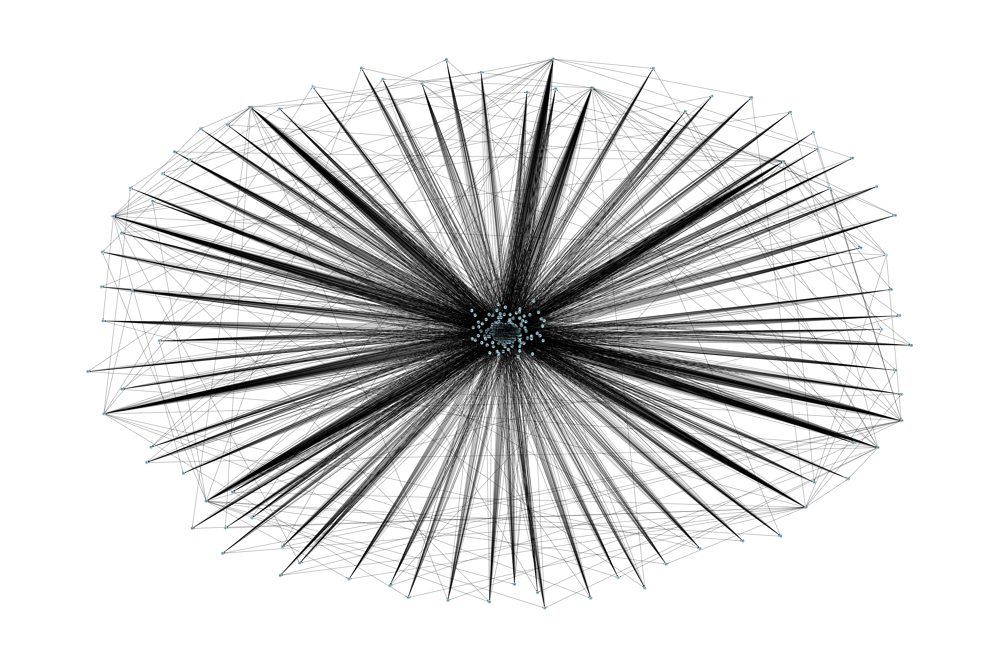

In [4]:
def visualize_graph(G):
    ## Use a layout algorithm (e.g., nx.spring_layout)
    pos = nx.spring_layout(G)

    # Choose a visualization library (e.g., matplotlib)
    plt.figure(figsize=(75, 50))
    nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='black')
    plt.show()
    
data = read_data("ball_to_ball_data.csv")  # Replace with your file name
G = create_graph(data)
visualize_graph(G)

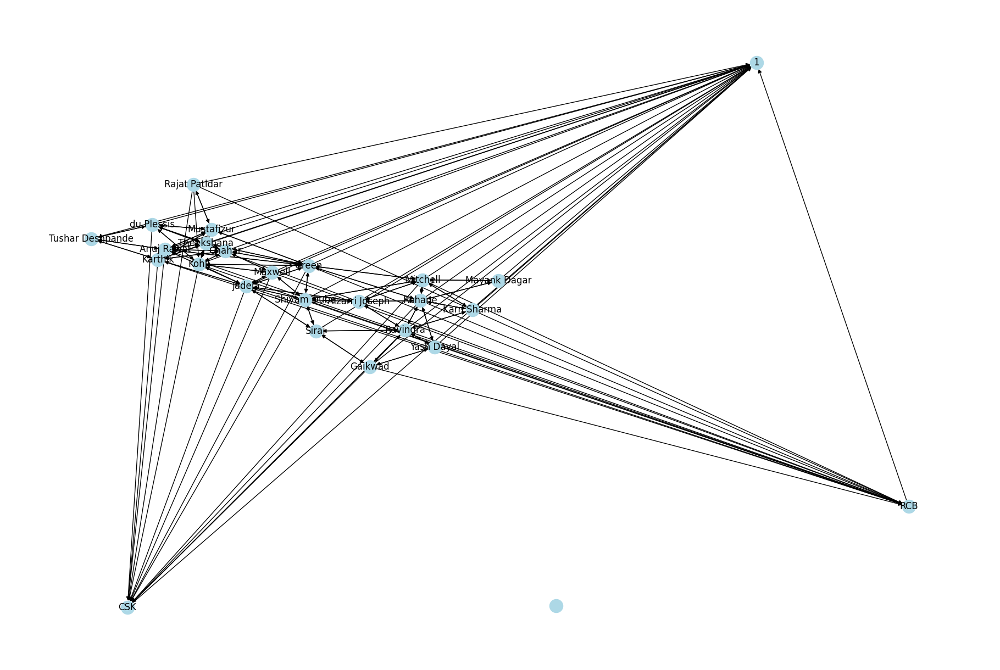

In [5]:
def visualize_graph(G):
    ## Use a layout algorithm (e.g., nx.spring_layout)
    pos = nx.spring_layout(G)

    # Choose a visualization library (e.g., matplotlib)
    plt.figure(figsize=(18, 12))
    nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='black')
    plt.show()

data = read_data("ball_to_ball.csv")  # Replace with your file name
G = create_graph(data)
visualize_graph(G)